<script>
    function findAncestor (el, name) {
        while ((el = el.parentElement) && el.nodeName.toLowerCase() !== name);
        return el;
    }
    function colorAll(el, textColor) {
        el.style.color = textColor;
        Array.from(el.children).forEach((e) => {colorAll(e, textColor);});
    }
    function setBackgroundImage(src, textColor) {
        var section = findAncestor(document.currentScript, 'section');
        if (section) {
            section.setAttribute('data-background-image', src);
			if (textColor) colorAll(section, textColor);
        }
    }
</script>

<style>
h1 {
  border: 1.5px solid #333;
  padding: 8px 12px;
  background-image: linear-gradient(#2774AE,#ebf8e1, #FFD100);
  position: static;
}
</style>

<h1 style='color:white'> Statistics 21 <br/> Python & Other Technologies for Data Science </h1>

<h3 style='color:white'>Vivian Lew, PhD - Wednesday, Week 5</h3>

<script>
    setBackgroundImage('Window1.jpg');
</script>

# Interactive Graphics: Plotly
## View this as html or in .ipynb
## Week 7 Monday


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display, Math, Latex

import warnings
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = 'jupyterlab+notebook+pdf'
%matplotlib inline

warnings.filterwarnings('ignore', category=UserWarning, module='openpyxl.worksheet.header_footer')

## Plotly

- Plotly is a data visualization library used to create interactive graphics, dashboards, webapps

- It integrates well with pandas, numpy

- You can generate all types of graphics: line plots, scatter plots, area charts, bar charts, error bars, box plots, histograms, heatmaps, many more.

- Plotly express is the entry point (easier to use) https://plotly.com/python/plotly-express/

## Get some data in there with the help of pandas

In [2]:
poke = pd.read_csv('pokemon.csv')
poke

,name,hp,height_m,weight_kg,type1,type2,speed,defense,attack,generation
0,Bulbasaur,45,0.7,6.9,grass,poison,45,49,49,1
1,Ivysaur,60,1.0,13.0,grass,poison,60,63,62,1
2,Venusaur,80,2.0,100.0,grass,poison,80,123,100,1
3,Charmander,39,0.6,8.5,fire,NaN,65,43,52,1
4,Charmeleon,58,1.1,19.0,fire,NaN,80,58,64,1
...,...,...,...,...,...,...,...,...,...,...
796,Celesteela,97,9.2,999.9,steel,flying,61,103,101,7
797,Kartana,59,0.3,0.1,grass,steel,109,131,181,7
798,Guzzlord,223,5.5,888.0,dark,dragon,43,53,101,7
799,Necrozma,97,2.4,230.0,psychic,NaN,79,101,107,7


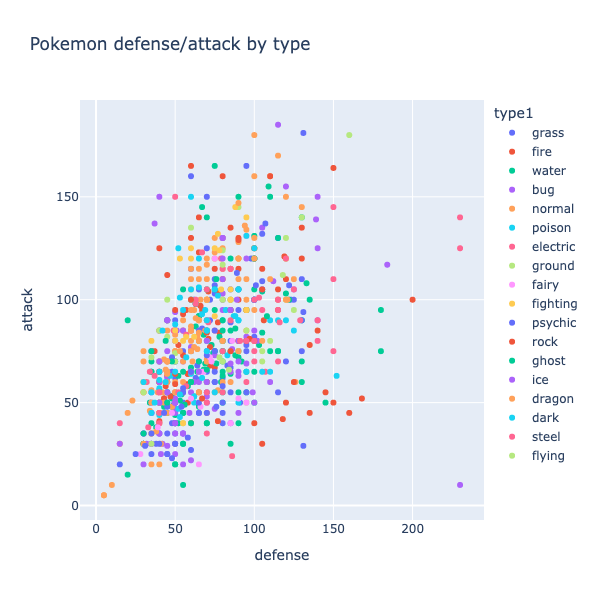

In [3]:
fig = px.scatter(poke, x='defense', y='attack', 
                 color='type1', hover_name='name',
                 title='Pokemon defense/attack by type',
                 height=600)
fig.show()

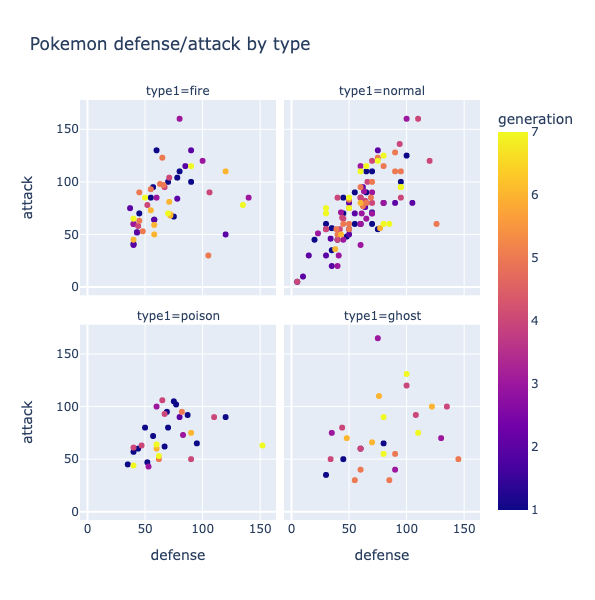

In [4]:
fig = px.scatter(poke[poke['type1'].isin(['normal', 'ghost', 'fire', 'poison'])], x='defense', y='attack', 
                 facet_col='type1', facet_col_wrap=2,
                 hover_name='name', color = 'generation',
                 title='Pokemon defense/attack by type',
                 height=600)
fig.show()

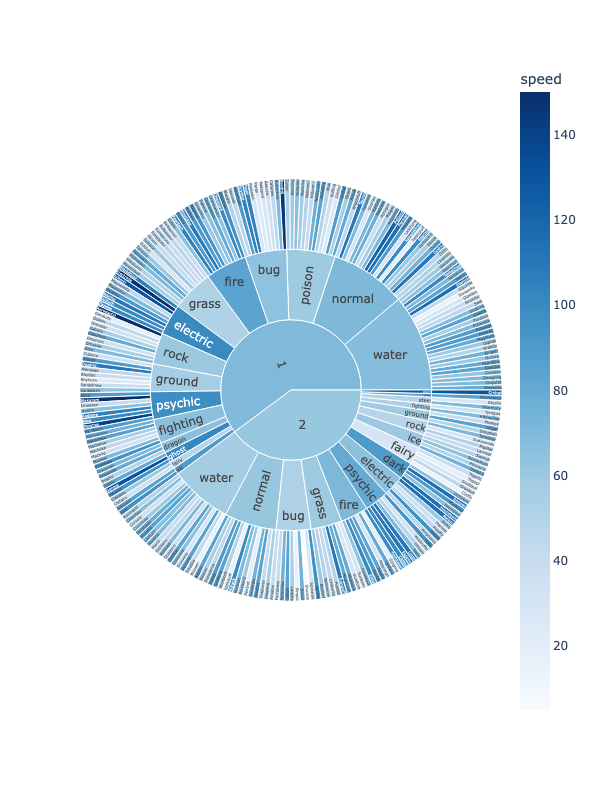

In [5]:
fig = px.sunburst(poke[poke['generation'] < 3], 
                  path=['generation', 'type1', 'name'], 
                  height=800, color='speed', 
                  color_continuous_scale='blues')
fig.show()

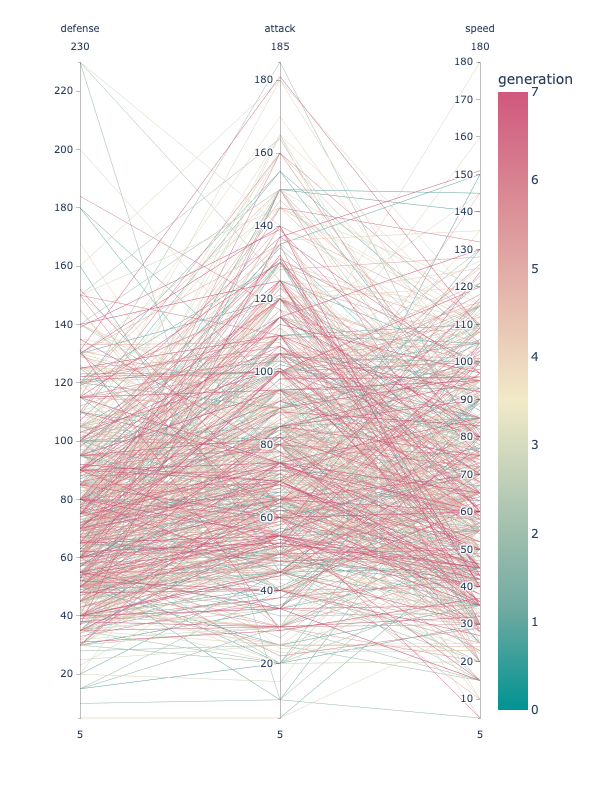

In [6]:
fig = px.parallel_coordinates(poke, color="generation",
                              dimensions=['defense', 'attack', 'speed'],
                              color_continuous_scale=px.colors.diverging.Tealrose,
                              color_continuous_midpoint=3.5,
                              height=800)
fig.show()

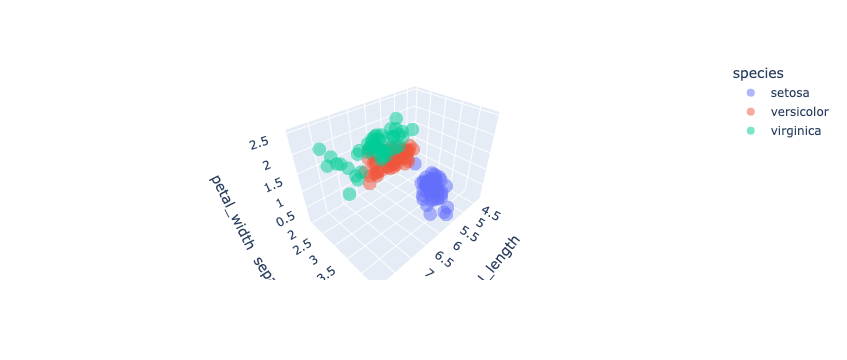

In [7]:
df = px.data.iris()
fig = px.scatter_3d(df, x='sepal_length', y='sepal_width',
                    z='petal_width', color='species', 
                    opacity=0.5)
fig.show()

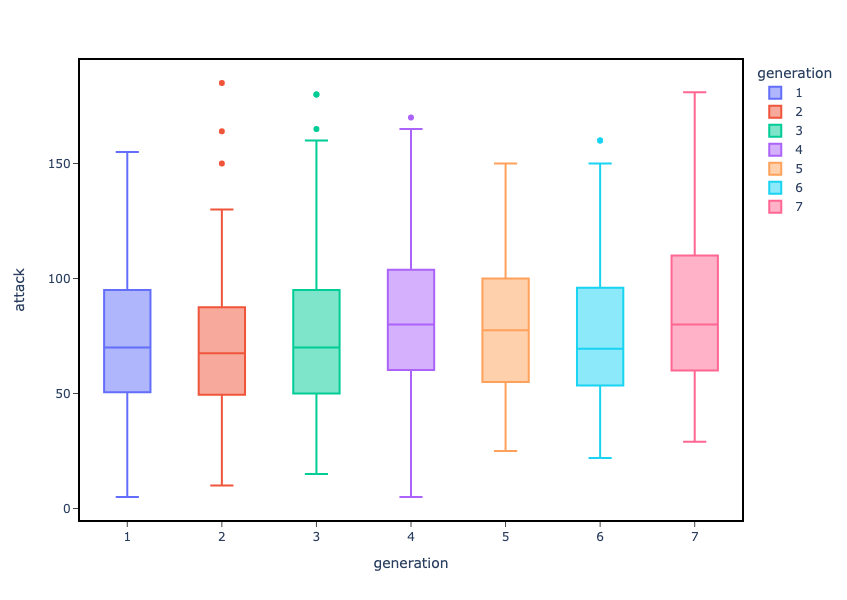

In [8]:
fig = px.box(poke, x='generation', y='attack', 
             color = 'generation', height=600)
fig.update_xaxes(showline=True, linewidth=2, ticks='outside',
                 linecolor='black', mirror=True)
fig.update_yaxes(showline=True, linewidth=2, ticks='outside',
                 linecolor='black', mirror=True)
fig.update_layout(plot_bgcolor='white')
fig.show()

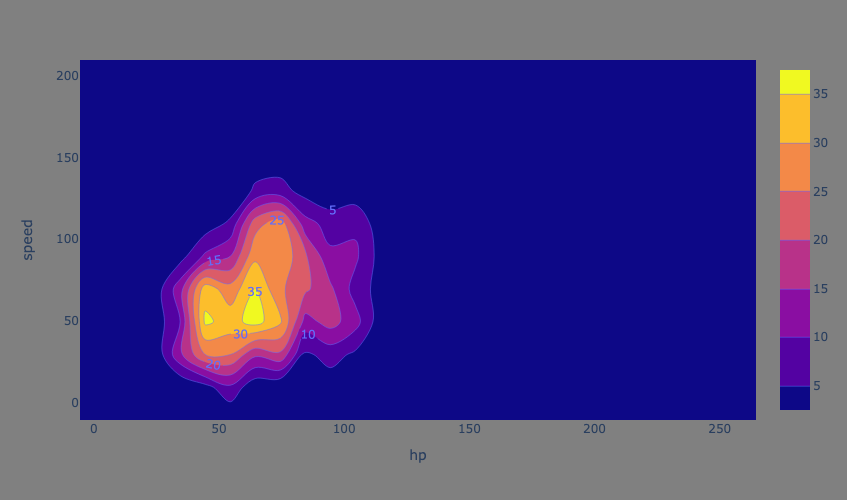

In [9]:
fig = px.density_contour(poke, x='hp', y='speed', 
                         height=500)
fig.update_traces(contours_coloring="fill", 
                  contours_showlabels = True)
fig.update_layout(paper_bgcolor='grey')
fig.show()

In [10]:
AAPL = pd.read_csv('AAPL.csv',
                   parse_dates = ['Date'])[['Date', 'Close']]
MSFT = pd.read_csv('MSFT.csv',
                   parse_dates = ['Date'])[['Date', 'Close']]
ZM = pd.read_csv('ZM.csv',parse_dates = ['Date'])[['Date', 'Close']]
PTON = pd.read_csv('PTON.csv',parse_dates = ['Date'])[['Date', 'Close']]
ZM

,Date,Close
0,2019-04-22,65.699997
1,2019-04-23,69.000000
2,2019-04-24,63.200001
3,2019-04-25,65.000000
4,2019-04-26,66.220001
...,...,...
1019,2023-05-08,62.930000
1020,2023-05-09,63.560001
1021,2023-05-10,64.430000
1022,2023-05-11,64.449997


## Add a Ticker column

- We're just adding a string constant

In [11]:
MSFT['Ticker'] = 'MSFT'
AAPL['Ticker'] = 'AAPL'
ZM['Ticker'] = 'ZM'
PTON['Ticker'] = 'PTON'

In [12]:
PTON

,Date,Close,Ticker
0,2019-09-27,25.24,PTON
1,2019-09-30,25.10,PTON
2,2019-10-01,22.51,PTON
3,2019-10-02,22.60,PTON
4,2019-10-03,22.33,PTON
...,...,...,...
908,2023-05-08,8.09,PTON
909,2023-05-09,7.83,PTON
910,2023-05-10,7.53,PTON
911,2023-05-11,6.86,PTON


## Created a "long" format dataset

If we want to put multiple lines on a plotly express graphic, plotly express likes the data to be in "long" (AKA tall, stacked) format.

Long Format has a column for each variable and within each column are all the values for all of the values.  MSFT is the first 1,024 rows PTON is the last 913 rows. 

In [13]:
ALL4 = pd.concat(objs = [MSFT, AAPL, ZM, PTON])
ALL4

,Date,Close,Ticker
0,2019-01-02,101.120003,MSFT
1,2019-01-03,97.400002,MSFT
2,2019-01-04,101.930000,MSFT
3,2019-01-07,102.059998,MSFT
4,2019-01-08,102.800003,MSFT
...,...,...,...
908,2023-05-08,8.090000,PTON
909,2023-05-09,7.830000,PTON
910,2023-05-10,7.530000,PTON
911,2023-05-11,6.860000,PTON


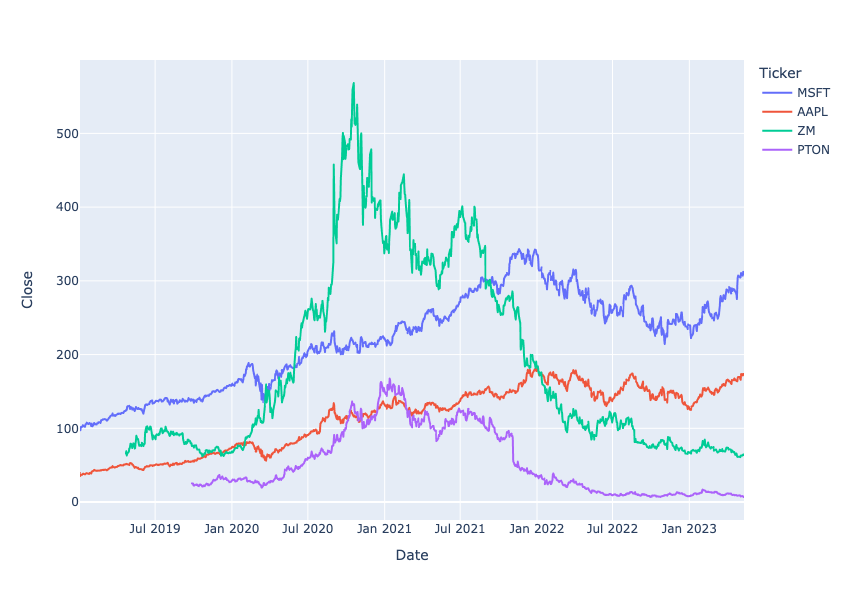

In [14]:
fig = px.line(ALL4, x='Date', y='Close', 
              color='Ticker', height=600)
fig.show()

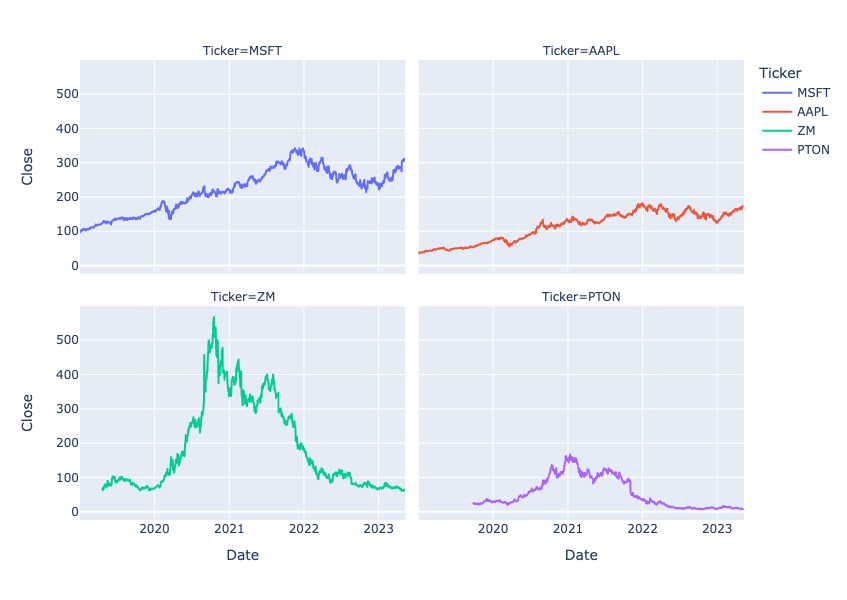

In [15]:
fig = px.line(ALL4, x='Date', y='Close', 
              facet_col='Ticker', facet_col_wrap=2,
              color='Ticker', height=600)
fig.show()

## Plotly Graph Objects

- The next step up from plotly express is plotly graph objects
- more powerful, flexible and detailed interface 
- construct plots using a more granular, step-by-step method

1. You start by creating a figure (layout) 
2. add traces (bars, lines, etc.) 
3. each trace has a type (like Scatter for line, Bar for bar plots, etc.) 
4. the trace is almost completely customizable

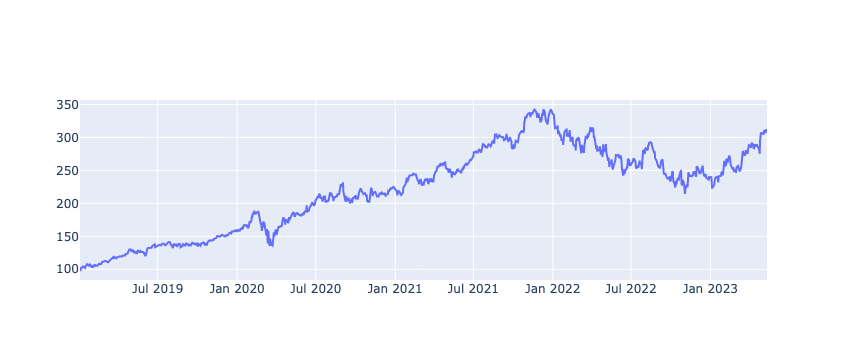

In [16]:
# Create a figure
fig = go.Figure()

# Add a line - add_trace is adding a subplot
fig.add_trace(go.Scatter(x=MSFT['Date'], y=MSFT['Close'], 
                         mode='lines', name='MSFT'))

fig.show()

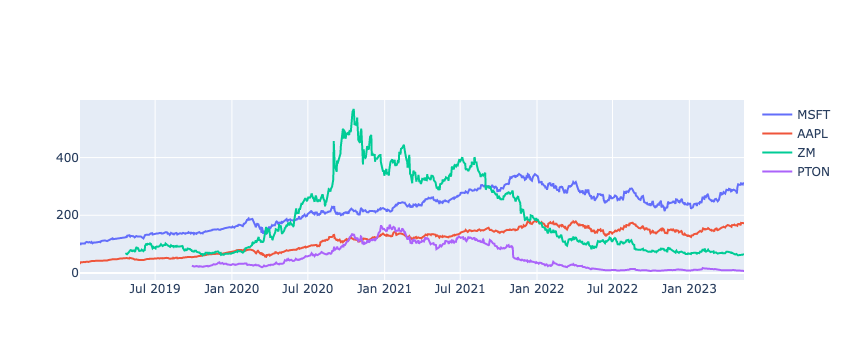

In [17]:
# Create a figure
fig = go.Figure()

# Add a line - add_trace is adding a subplot
fig.add_trace(go.Scatter(x=MSFT['Date'], y=MSFT['Close'], 
                         mode='lines', name='MSFT'))
# Add another line 
fig.add_trace(go.Scatter(x=AAPL['Date'], y=AAPL['Close'], 
                         mode='lines', name='AAPL'))
# and another line 
fig.add_trace(go.Scatter(x=ZM['Date'], y=ZM['Close'], 
                         mode='lines', name='ZM'))
# etc.
fig.add_trace(go.Scatter(x=PTON['Date'], y=PTON['Close'], 
                         mode='lines', name='PTON'))

fig.show()

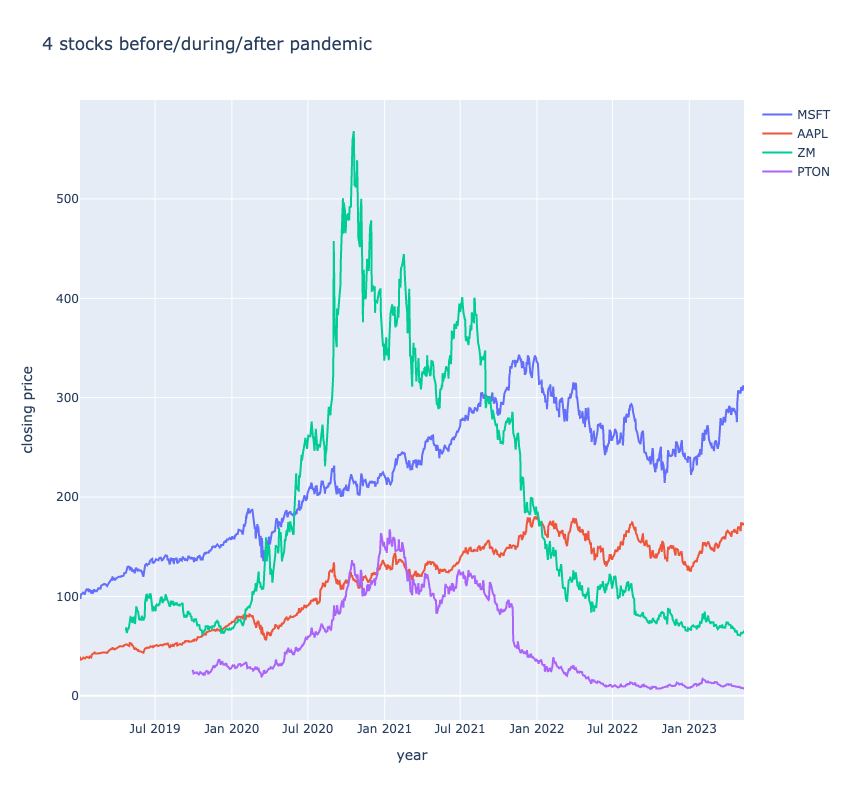

In [18]:
# Create a figure
fig = go.Figure(layout=go.Layout(
        width=750,
        height=800,
        title = '4 stocks before/during/after pandemic',
        xaxis = dict(title= 'year'),
        yaxis = dict(title= 'closing price')))

# Add the Microsoft line - add_trace is adding a subplot
fig.add_trace(go.Scatter(x=MSFT['Date'], y=MSFT['Close'], 
                         mode='lines', name='MSFT'))

fig.add_trace(go.Scatter(x=AAPL['Date'], y=AAPL['Close'], 
                         mode='lines', name='AAPL'))

fig.add_trace(go.Scatter(x=ZM['Date'], y=ZM['Close'], 
                         mode='lines', name='ZM'))

fig.add_trace(go.Scatter(x=PTON['Date'], y=PTON['Close'], 
                         mode='lines', name='PTON'))

fig.show()

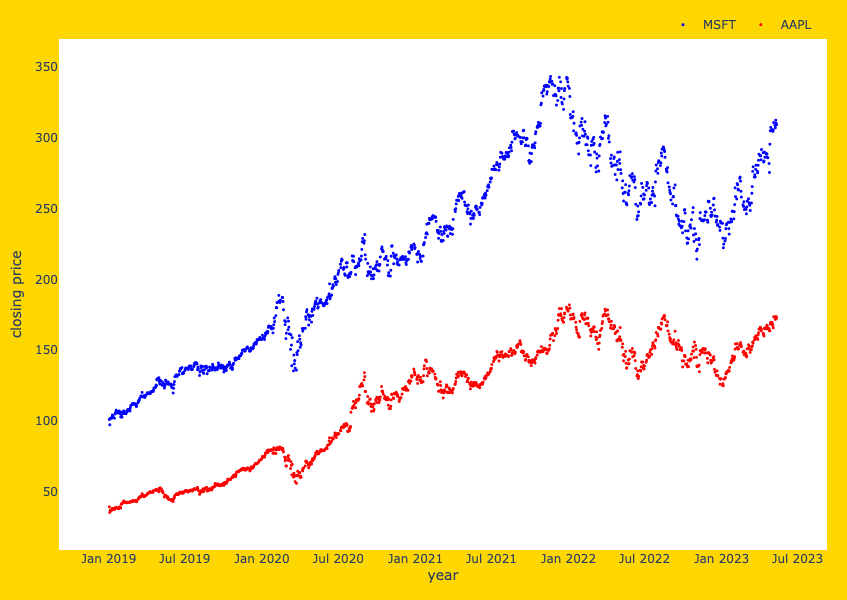

In [19]:
# Create a figure with even more modifications
fig = go.Figure(layout=go.Layout(
        width=700, height=600,
        plot_bgcolor = 'white',
        paper_bgcolor= 'gold',
        margin=dict(
            l=10,  # left margin
            r=30,  # right margin
            b=10,  # bottom margin
            t=30,  # top margin
            pad=10  # padding
        ),
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.02,
            xanchor="right",
            x=1
        ),
       xaxis = dict(title= 'year'),
       yaxis = dict(title= 'closing price')
    ))

# Add the Microsoft line - add_trace is adding a subplot
fig.add_trace(go.Scatter(x=MSFT['Date'], y=MSFT['Close'], 
                         mode='markers', name='MSFT',
                         marker=dict(size=3, color='blue')))
# etc.
fig.add_trace(go.Scatter(x=AAPL['Date'], y=AAPL['Close'], 
                         mode='markers', name='AAPL',
                         marker=dict(size=3, color='red')))

fig.show()

## Mapping with plotly

plotly can create maps for example

- Scatter Plots on Maps show the locations of data points spatially. 

- Choropleth Maps have colored or patterned areas related to the value of a variable associated with the area. 

- The next example is from plotly's website

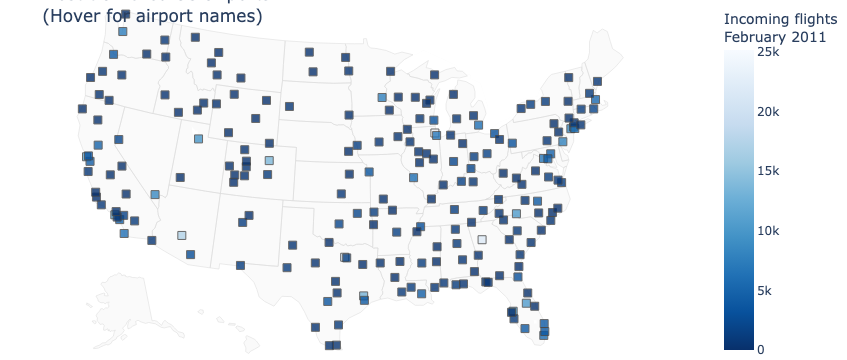

In [20]:
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2011_february_us_airport_traffic.csv')
df['text'] = df['airport'] + '' + df['city'] + ', ' + df['state'] + \
            '' + 'Arrivals: ' + df['cnt'].astype(str)

fig = go.Figure(data=go.Scattergeo(
        locationmode = 'USA-states',
        lon = df['long'], lat = df['lat'],
        text = df['text'], mode = 'markers',
        marker = dict(
            size = 8,
            opacity = 0.8,
            reversescale = True,
            autocolorscale = False,
            symbol = 'square',
            line = dict(
                width=1,
                color='rgba(102, 102, 102)'
            ),
            colorscale = 'Blues',
            cmin = 0,
            color = df['cnt'],
            cmax = df['cnt'].max(),
            colorbar_title="Incoming flights<br>February 2011"
        )))

fig.update_layout(
        title = 'Most trafficked US airports<br>(Hover for airport names)',
        margin={"r":0,"t":0,"l":0,"b":0},
        geo = dict(
            scope='usa',
            projection_type='albers usa',
            showland = True,
            landcolor = "rgb(250, 250, 250)",
            subunitcolor = "rgb(217, 217, 217)",
            countrycolor = "rgb(217, 217, 217)",
            countrywidth = 0.5,
            subunitwidth = 0.5
        ),
    )
fig.show()

## Global Map

- We can find our own data and add customizations

In [21]:
df = pd.read_csv('All_Starbucks_Locations_in_the_World.csv')
df['text'] = df['Name'] + '' + df['Country Subdivision'].astype(str)

SB = df[['text', 'Latitude', 'Longitude']]

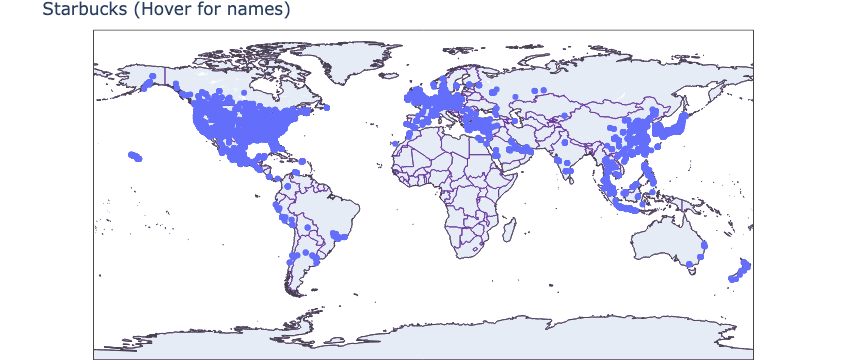

In [22]:
fig = go.Figure(data=go.Scattergeo(
        lon = SB['Longitude'], lat = SB['Latitude'],
        text = SB['text'], mode = 'markers')
               )

fig.update_layout(
        title = 'Starbucks (Hover for names)',
        margin={"r":0,"t":30,"l":0,"b":0},
        geo = dict(
            resolution=50,
            showcountries=True, 
            countrycolor="RebeccaPurple",
            showland = True
        ),
    )

fig.show()

### Local area

Plotly is great for large geographic areas (nations, world) but local areas...

Here is an example for a local area (Los Angeles) 

First, some data and creating a text field for hovering.

In [23]:
df = pd.read_csv('Private_and_Charter_Schools.csv')[['X','Y',
        'Name', 'addrln1', 'city', 'zip']]
df['text'] = df['Name'] + '' + df['addrln1'] +\
        '' + df['city']+ '' + df['zip'].astype(str)


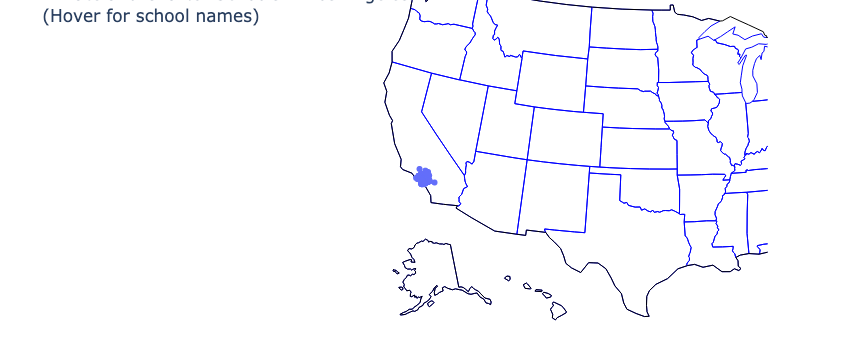

In [24]:
fig = go.Figure(data=go.Scattergeo(
        lon = df['X'],
        lat = df['Y'],
        text = df['text'],
        mode = 'markers'
        ))
fig.update_layout(
        margin={"r":0,"t":0,"l":0,"b":0},
        title = 'Private and Charter Schools in Los Angeles<br>(Hover for school names)'
    )
fig.update_geos(
    visible=False, resolution=110, scope="usa",
    showcountries=True, countrycolor="Black",
    showsubunits=True, subunitcolor="Blue",
    center_lat= 34.06258325620414, 
    center_lon= -118.25912552934548
)
fig.show()

## Choropleth maps

Choropleth maps color or fill regions to help display distributions spatially.  First, some data

In [25]:
# poverty levels for each state
pov = pd.read_csv('STATE_POV.csv')
pov.head()

,STATE,POV
0,AL,14.9
1,AK,9.6
2,AZ,12.8
3,AR,15.2
4,CA,11.5


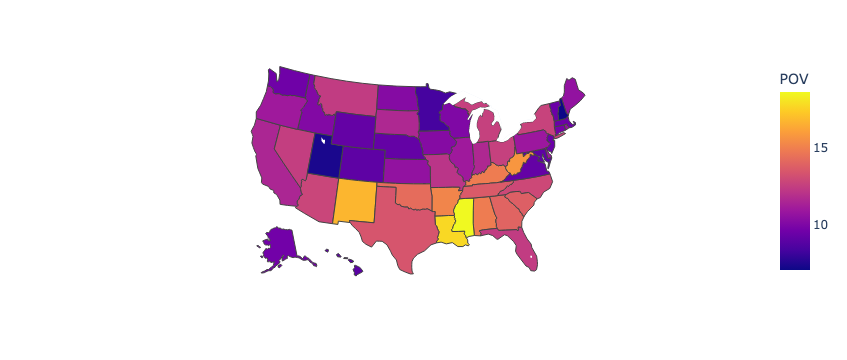

In [26]:
# using plotly's built-in areas
fig = px.choropleth(pov, locations='STATE', 
                    color = 'POV',
                    locationmode="USA-states",
                    scope="usa")
fig.show()

### Using a custom made area

This is a .json file from US government with county boundaries for each state.   We can read it into Python using the json reader from the Python Standard Library:

In [27]:
import json
# Open the file
with open('geojson-counties-fips.json', 'r') as f:
    # Load the JSON data from the file
    counties = json.load(f)

In [28]:
counties['features'][0]

{'type': 'Feature',
 'properties': {'GEO_ID': '0500000US01001',
  'STATE': '01',
  'COUNTY': '001',
  'NAME': 'Autauga',
  'LSAD': 'County',
  'CENSUSAREA': 594.436},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-86.496774, 32.344437],
    [-86.717897, 32.402814],
    [-86.814912, 32.340803],
    [-86.890581, 32.502974],
    [-86.917595, 32.664169],
    [-86.71339, 32.661732],
    [-86.714219, 32.705694],
    [-86.413116, 32.707386],
    [-86.411172, 32.409937],
    [-86.496774, 32.344437]]]},
 'id': '01001'}

### County Level Data

We have data which is associated with the counties of the US

In [29]:
pov = pd.read_csv('PovertyEstimates.csv', 
                  dtype={'id': str})
pov

,id,Stabr,Area_name,Urban_Code,PCTPOVALL_2020
0,01001,AL,Autauga County,2,11.2
1,01003,AL,Baldwin County,3,8.9
2,01005,AL,Barbour County,6,25.5
3,01007,AL,Bibb County,1,17.8
4,01009,AL,Blount County,1,13.1
...,...,...,...,...,...
3136,56037,WY,Sweetwater County,5,7.6
3137,56039,WY,Teton County,7,5.2
3138,56041,WY,Uinta County,7,8.5
3139,56043,WY,Washakie County,7,9.7


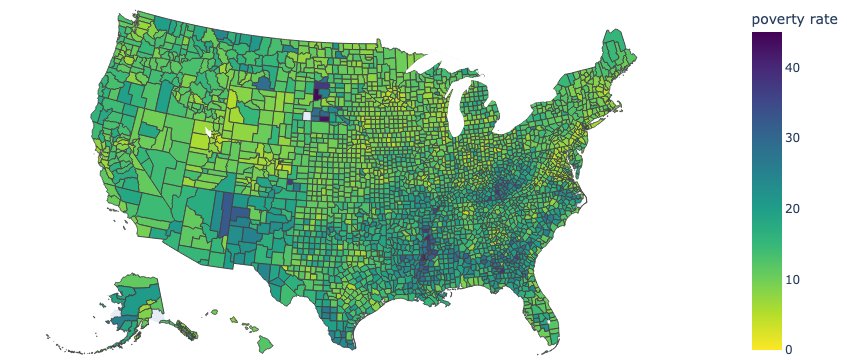

In [30]:
fig = px.choropleth(pov, geojson=counties, locations='id', 
                    color='PCTPOVALL_2020',
                    color_continuous_scale='Viridis_r',
                    hover_name='Area_name',
                    range_color=(0, 45),
                    scope='usa',
                    labels={'PCTPOVALL_2020':'poverty rate'})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

<h1> Statistics 21 <br/> Have a good night! </h1>

<script>
    setBackgroundImage('Window1.jpg', 'black');
</script>